

# 1. Introduction
---

Pix2Pix GANS takes an image from one domain as input and outputs the corresponding image in the other domain.
The aim of this task is to implement paired image-to-image translation using the Pix2Pix architecture on the Dayton dataset.
Further, we qualitatively as well as quantitatively evaluate this model using the Frechet Inception Distance (FID) and Inception Score (IS) evaluation metrics.

# 2. Getting Started
---

## Loading required packages

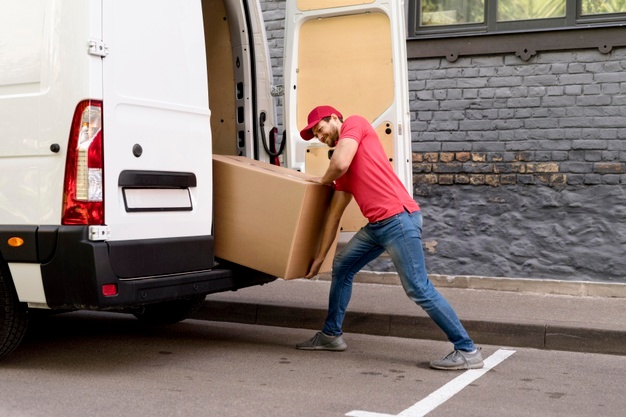

In [3]:
# !pip3 install torchmetrics
# !pip3 install torchmetrics[images]
# !pip3 install torch-fidelity

In [4]:
import os
import math
import cv2
import torch
import numpy as np
import torchvision
from PIL import Image
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torch.utils.tensorboard import SummaryWriter
from torch.utils.data import Dataset, DataLoader
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid, save_image
from torchvision import utils as vutils
import torchvision.transforms as transforms
#For calculating evaluation metrics
from torchmetrics.image.fid import FrechetInceptionDistance
from torchmetrics.image.inception import InceptionScore

# Configuration Specification
---

Device Specific Configurations to help run it easily on ILabs

In [48]:
device = torch.device("cuda:0")  
curr_test_name = "arieal_to_street_b24_e50"
ids = [0]

Configuratoin Settings in case the process is terminated.
Checkpointing

In [6]:
resume = True
resume_epoch = 50
resume_generator_path = '/common/home/jrp328/Downloads/results_arieal_to_street_b24_e50/models/arial_to_street_b24_e50/genr_50.pth'
resume_discriminator_path = '/common/home/jrp328/Downloads/results_arieal_to_street_b24_e50/models/arial_to_street_b24_e50/discr_50.pth'

## Training Parameters

Basic Image Parameters

In [7]:
IMG_HEIGHT, IMG_WIDTH, image_size = 256, 256, 256

Basic Training Parameters

In [8]:
batch_size = 24
epochs = 75  
lr = 0.0002

## Logging using Tensorboard

In [9]:
target_path = f"results_{curr_test_name}"
os.makedirs(target_path, exist_ok=True)

models_bank =  os.path.join(f"{target_path}/model_bank", curr_test_name)
os.makedirs(models_bank, exist_ok=True)

images_dir = os.path.join(f"{target_path}/images", curr_test_name)
os.makedirs(images_dir, exist_ok=True)

In [10]:
logger = SummaryWriter(os.path.join(f"{target_path}/logs", "evaluation_metrics", curr_test_name))

# Loading the Data and Preprocessing
---

Using the augmented data

In [11]:
train_data_path = '/common/home/jrp328/Downloads/task3_as/arieal_to_street/train'
valid_data_path = '/common/home/jrp328/Downloads/task3_as/arieal_to_street/validation'

In [12]:
def load_image(image):
  image = np.array(image)
  w = image.shape[1]
  middle = w // 2
  real , target = image[:, :middle, :], image[:, middle:, :]
  real, target = real.astype(np.float32), target.astype(np.float32)
  return real, target

## Image Transformations

### Crop Images

In [13]:
def crop_images(image, dim):
    h, w, _ = dim
    x, y = np.random.uniform(low=0,high=int(h-256)), np.random.uniform(low=0,high=int(w-256))  
    return image[:, int(x):int(x)+256, int(y):int(y)+256]

### Add Jitter and Randomly Mirror Images

In [14]:
def add_jitter_mirroring(input_image, target_image, h=256, w=256):
  input_image = cv2.resize(input_image, (h, w) ,interpolation=cv2.INTER_NEAREST)
  target_image = cv2.resize(target_image, (h, w),interpolation=cv2.INTER_NEAREST)
  stacked_image = np.stack([input_image, target_image], axis=0)
  cropped_image = crop_images(stacked_image, dim=[IMG_HEIGHT, IMG_WIDTH, 3])
  input_image, target_image = cropped_image[0], cropped_image[1]
  if torch.rand(()) > 0.5:
    input_image = np.fliplr(input_image)
    target_image = np.fliplr(target_image)
  return input_image, target_image

### Normalize Images

In [15]:
def normalize_image(input_image, target_image):
  return (input_image / 127.5) - 1, (target_image / 127.5) - 1

## DataLoaders
---

In [16]:
class Transformations(object):
    def __call__(self, image):
        inp, tar = load_image(image)
        inp, tar = add_jitter_mirroring(inp, tar)
        inp, tar = normalize_image(inp, tar)
        image_a = torch.from_numpy(inp.copy().transpose((2,0,1)))
        image_b = torch.from_numpy(tar.copy().transpose((2,0,1)))
        return image_a, image_b

In [17]:
train_ds = ImageFolder(train_data_path, transform=transforms.Compose([Transformations()]))
train_dl = DataLoader(train_ds, batch_size)

#### Validation Set consists of 10 randomly selected images from the test data

In [18]:
valid_ds = ImageFolder(valid_data_path, transform=transforms.Compose([Transformations()]))
valid_dl = DataLoader(valid_ds, batch_size)

## Initialize Weights
---

In [19]:
def init_weights(neural_net, init_type='normal', scaling=0.02):
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and (classname.find('Conv')) != -1:
            torch.nn.init.normal_(m.weight.data, 0.0, scaling)
        elif classname.find('BatchNorm2d') != -1:
            torch.nn.init.normal_(m.weight.data, 1.0, scaling)
            torch.nn.init.constant_(m.bias.data, 0.0)
    neural_net.apply(init_func)

## Defining U-Net Generator
---

The Generator architecture  makes use of skip connection to ensure that more features flow from input to output during forward propagation and gradients from loss to parameters during back-propagation. 

In [58]:
class SkipConn(nn.Module):
  def __init__(self, outer_nc, inner_nc, input_nc=None,submodule=None, last=False, first=False, norm_layer=nn.BatchNorm2d, use_dropout=False):
    super(SkipConn, self).__init__()
    self.last = last
    if input_nc is None:
        input_nc = outer_nc
    downconv = nn.Conv2d(input_nc, inner_nc, kernel_size=4,stride=2, padding=1, bias=False)
    downrelu , uprelu = nn.LeakyReLU(0.2, True), nn.ReLU(True)
    downnorm, upnorm = norm_layer(inner_nc), norm_layer(outer_nc)
    if first:
      upconv = nn.ConvTranspose2d(inner_nc, outer_nc,kernel_size=4, stride=2,padding=1, bias=False)
      downsampling, upsampling = [downrelu, downconv] , [uprelu, upconv, upnorm]
      model = downsampling + upsampling
    elif last:
      upconv = nn.ConvTranspose2d(inner_nc * 2, outer_nc,kernel_size=4, stride=2, padding=1)
      downsampling, upsampling = [downconv], [uprelu, upconv, nn.Tanh()]
      model = downsampling + [submodule] + upsampling
    else:
      upconv = nn.ConvTranspose2d(inner_nc * 2, outer_nc,kernel_size=4, stride=2,padding=1, bias=False)
      downsampling, upsampling = [downrelu, downconv, downnorm], [uprelu, upconv, upnorm]
      if use_dropout:
        model = downsampling + [submodule] + upsampling + [nn.Dropout(0.5)]
      else:
        model = downsampling + [submodule] + upsampling
    self.model = nn.Sequential(*model)

  def forward(self, x):
    if self.outermost:
      return self.model(x)
    else:
      return torch.cat([x, self.model(x)], 1)

In [59]:
class U_NetGenerator(nn.Module):
  def __init__(self, input_nc, output_nc, f=64, norm_layer=nn.BatchNorm2d, use_dropout=False):
    super(U_NetGenerator, self).__init__()
    unet_block = SkipConn(f * 8, f * 8, input_nc=None, submodule=None, norm_layer=norm_layer, first=True) 
    unet_block = SkipConn(f * 8, f * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
    unet_block = SkipConn(f * 8, f * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
    unet_block = SkipConn(f * 8, f * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
    unet_block = SkipConn(f * 4, f * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
    unet_block = SkipConn(f * 2, f * 4, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
    unet_block = SkipConn(f, f * 2, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
    self.model = SkipConn(output_nc, f, input_nc=input_nc, submodule=unet_block, last=True, norm_layer=norm_layer)
  def forward(self, input):
    return self.model(input)

## Defining Discriminator
---

The discriminator architecture is similar to earlier GANs used by us.
However instead of classifying a whole image as real or fake, the architecture used in Pix2Pix GANs classifies patches of an image as real or fake by outputting a matrix of values as output instead of a single value. The reason for this is to encourage sharp high frequency detail and also to reduce the number of parameters.

In [60]:
class Discriminator(nn.Module):
  def __init__(self, input_nc, ndf=64, n_layers=3, norm_layer=nn.BatchNorm2d):
    super(Discriminator, self).__init__()
    kw = 4
    padw = 1
    sequence = [nn.Conv2d(input_nc, ndf, kernel_size=kw, stride=2, padding=padw), nn.LeakyReLU(0.2, True)]
    nf_mult = 1
    nf_mult_prev = 1
    for n in range(1, n_layers):
        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n, 8)
        sequence += [
            nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=2, padding=padw, bias=False),
            norm_layer(ndf * nf_mult),
            nn.LeakyReLU(0.2, True)
        ]
    nf_mult_prev = nf_mult
    nf_mult = min(2 ** n_layers, 8)
    sequence += [
        nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=1, padding=padw, bias=False),
        norm_layer(ndf * nf_mult),
        nn.LeakyReLU(0.2, True)
    ]
    sequence += [nn.Conv2d(ndf * nf_mult, 1, kernel_size=kw, stride=1, padding=padw), nn.Sigmoid()]
    self.model = nn.Sequential(*sequence)

  def forward(self, input):
      return self.model(input)

## Initialize Generator & Discriminator
---

### Generator

In [61]:
generator = U_NetGenerator(3, 3, 64, norm_layer=nn.BatchNorm2d, use_dropout=False).cuda().float()
init_weights(generator, 'normal', scaling=0.02)
generator = torch.nn.DataParallel(generator, device_ids=ids)

### Discriminator

In [62]:
discriminator = Discriminator( 6, 64, norm_layer=nn.BatchNorm2d).cuda().float()
init_weights(discriminator, 'normal', scaling=0.02)
discriminator = torch.nn.DataParallel(discriminator, device_ids=ids)

## Loss Functions
---

In [63]:
criterion = nn.BCELoss() 
l1_loss = nn.L1Loss()

### Generator Loss

In [64]:
def generator_loss(generated_image, target_img, G, real_target):
    loss = criterion(G, real_target)
    l1_l = l1_loss(generated_image, target_img)
    total_loss = loss + (100 * l1_l)
    return total_loss

### Discriminator Loss

In [65]:
def discriminator_loss(output, label):
    loss = criterion(output, label)
    return loss

## Calculate & Log Evaluation Metrics
---

In [66]:
def evaluate_fid(input,generated,epoch_no):
  target_image = torch.tensor(input.clone().detach().cpu().numpy(), dtype=torch.uint8)
  generated_image = torch.tensor(generated.clone().detach().cpu().numpy(), dtype=torch.uint8)
  fid = FrechetInceptionDistance()
  fid.update(target_image, real=True)
  fid.update(generated_image, real=False)
  fid_score = fid.compute()
  logger.add_scalar('FID', fid_score, epoch_no)
  return fid

In [67]:
def evaluate_inception_scores(input,generated,epoch_no):
  target_image = torch.tensor(input.clone().detach().cpu().numpy(), dtype=torch.uint8)
  generated_image = torch.tensor(generated.clone().detach().cpu().numpy(), dtype=torch.uint8)
  inception_score = InceptionScore()
  inception_score.update(generated_image)
  inception_score_mean, inception_score_std = inception_score.compute()
  logger.add_scalar('IS_mean', inception_score_mean, epoch_no)
  logger.add_scalar('IS_std', inception_score_std, epoch_no)
  return inception_score_mean, inception_score_std

## Training Helper Function to Save Images
---

In [68]:
def log_and_evaluate(epoch=1):
  for (inputs, targets), _ in valid_dl:
    inputs = inputs.to(device)
    targets = targets.to(device)
    generated_output =  generator(inputs)
    evaluate_fid(targets, generated_output,epoch)
    evaluate_inception_scores(targets, generated_output,epoch)
    save_image(generated_output.data[:10], f"./{images_dir}/epoch_{epoch}.png", nrow=2, normalize=True)    
    if(epoch%10 == 0):
      im_grid = vutils.make_grid(generated_output.data[:10], padding = 2, normalize=True, nrow = 2).cpu()
      plt.figure(figsize=(16,16))
      plt.title(f'Images after {epoch} epochs')
      plt.axis("off")
      plt.imshow(np.transpose(im_grid))

## Training
---

### Defining Optimizers

In [69]:
D_optimizer = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
G_optimizer = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))

### Generator
---

In [70]:
def train_gen(input_img,generated_image,real_target,G_optimizer):
  G_optimizer.zero_grad()
  fake_gen = torch.cat((input_img, generated_image), 1)
  G = discriminator(fake_gen)
  G_loss = generator_loss(generated_image, target_img, G, real_target)                                 
  G_loss.backward()
  G_optimizer.step()
  return G_loss

### Discriminator

In [71]:
def train_disc(input_img,generated_image,D_optimizer):
  D_optimizer.zero_grad()
  disc_inp_fake = torch.cat((input_img, generated_image), 1)
  D_fake = discriminator(disc_inp_fake.detach())
  fake_target = torch.zeros_like(D_fake,device=device)
  D_fake_loss   =  discriminator_loss(D_fake, fake_target)
  disc_inp_real = torch.cat((input_img, target_img), 1)                  
  D_real = discriminator(disc_inp_real)
  real_target = torch.ones_like(D_real, device=device)
  D_real_loss = discriminator_loss(D_real,  real_target)
  D_total_loss = (D_real_loss + D_fake_loss) / 2
  D_total_loss.backward()
  D_optimizer.step()
  return real_target,D_total_loss,D_real_loss,D_fake_loss

### Training Loop

Resume if Interrupted

In [ ]:
epoch_start = 0
if resume == True:
  epoch_start = resume_epoch
  print(f'Resuming Training from {resume_epoch}')
  generator.load_state_dict(torch.load(resume_generator_path))
  discriminator.load_state_dict(torch.load(resume_discriminator_path))

Resuming Training from 50


Training Loop

In [ ]:
batches = len(train_dl)
print(batches)
for epoch in range(epoch_start+1, epochs+1): 
    counter=0
    for (input_img, target_img), _ in train_dl:
        counter+=1
        input_img, target_img = input_img.to(device), target_img.to(device)
        generated_image = generator(input_img)
        real_target,disc_loss,D_x,D_G_z = train_disc(input_img,generated_image,D_optimizer)
        genr_loss = train_gen(input_img,generated_image,real_target,G_optimizer)
        iters = counter+epoch*batches+1
        logger.add_scalar("D_Loss",disc_loss,iters)
        logger.add_scalar("G_Loss",genr_loss,iters)
        logger.add_scalar("D_Real_Loss",D_x,iters)
        logger.add_scalar("D_Fake_Loss",D_G_z,iters)
        if counter%300 == 0:
            print(f' Current Epoch {epoch} of {epochs},Batch {counter},| Discriminator loss:{disc_loss}, | Generator Loss:{genr_loss}')
    log_and_evaluate(epoch)
    if epoch%5 == 0:
        torch.save(discriminator.state_dict(), os.path.join(models_bank, f"discr_{epoch}.pth"))
        torch.save(generator.state_dict(), os.path.join(models_bank, f"genr_{epoch}.pth"))

## Garbage Collect

In [72]:
import gc
gc.collect()

112811

## Qualitatively Evaluate the performance of Pix2Pix 
---

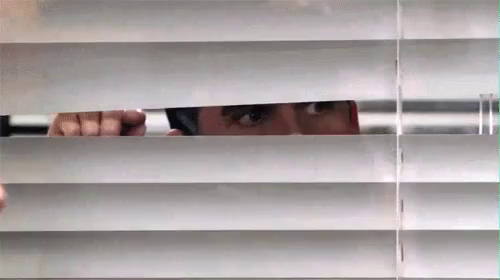

In [24]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [25]:
train_10_data_path= "/content/drive/MyDrive/Pix2Pix/Data Processing/Task3_Datasets/as/train_10"
test_10_data_path = "/content/drive/MyDrive/Pix2Pix/Data Processing/Task3_Datasets/as/test_10"

In [46]:
def qualitative_evaluation(data_loader, epoch_no, batch_size = 24):
  if batch_size == 24:
    generator.load_state_dict(torch.load(f"/content/drive/MyDrive/Pix2Pix/Batch-Size 24 75 Epochs/results_arial_to_street_b24_e50/models_bank/arial_to_street_b24_e50/generator_{epoch_no}.pth", map_location = 'cuda:0'))
  elif batch_size == 128:
    generator.load_state_dict(torch.load(f"/content/drive/MyDrive/Pix2Pix/overview_to_street_200_epochs/models_bank/generator_{epoch_no}.pth", map_location = 'cuda:0'))
  elif batch_size == 1:
    generator.load_state_dict(torch.load(f"/content/drive/MyDrive/Pix2Pix/Batch Size 1/results_arial_to_street_batch_size_1/models_bank/arial_to_street_batch_size_1/generator_{epoch_no}.pth"))
  for (inputs, targets), _ in data_loader:
    inputs = inputs.to(device)
    targets = targets.to(device)
    generated_output =  generator(inputs)
    im_grid1 = vutils.make_grid(targets.data[:10], padding = 2, normalize=True, nrow = 1).cpu()
    plt.figure(figsize=(22,16))
    plt.title("Target Images")
    plt.axis("off")
    plt.imshow(np.transpose(im_grid1))
    im_grid = vutils.make_grid(generated_output.data[:10], padding = 2, normalize=True, nrow = 1).cpu()
    plt.figure(figsize=(22,16))
    plt.axis("off")
    plt.title(f"Generated Images After {epoch_no} Epoch and Batch Size of {batch_size}")
    plt.imshow(np.transpose(im_grid))

### Batch Size 128 -> 200 Epochs
---

### Train Dataset

In [27]:
train_10_ds = ImageFolder(train_10_data_path, transform=transforms.Compose([Transformations()]))
train_10_dl = DataLoader(train_10_ds, batch_size, shuffle=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


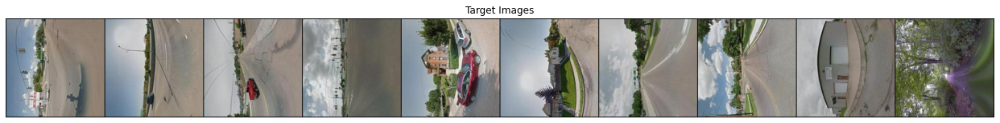

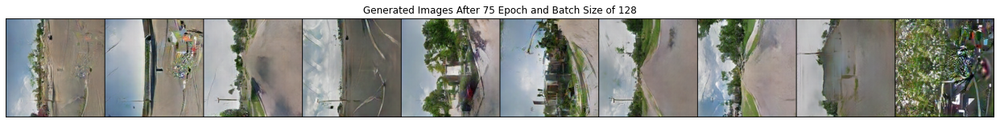

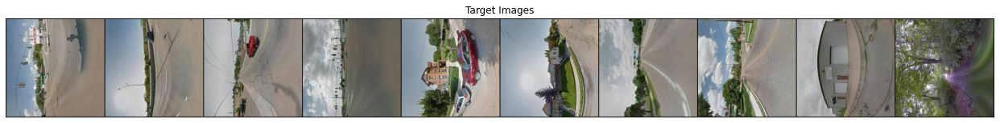

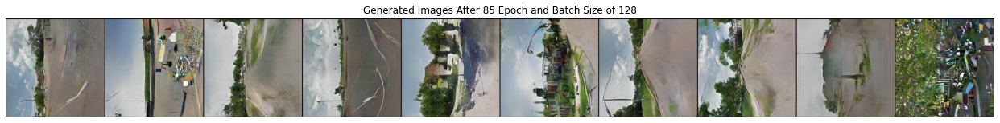

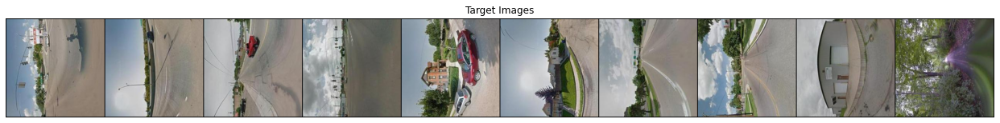

...

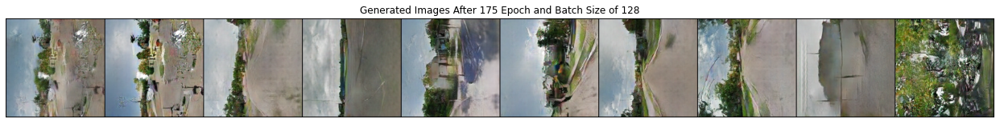

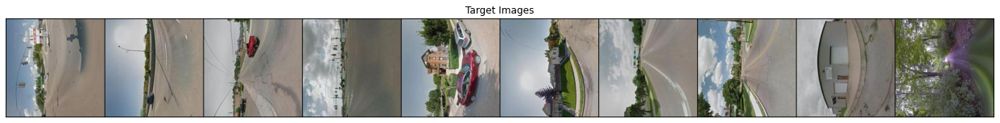

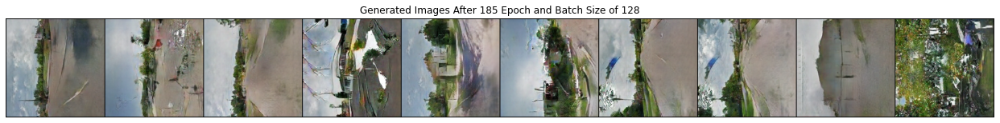

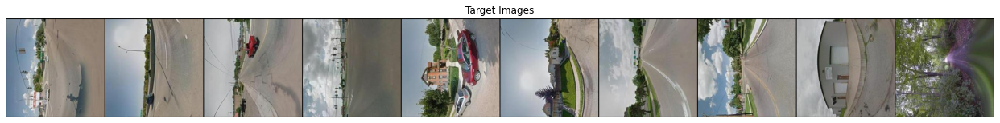

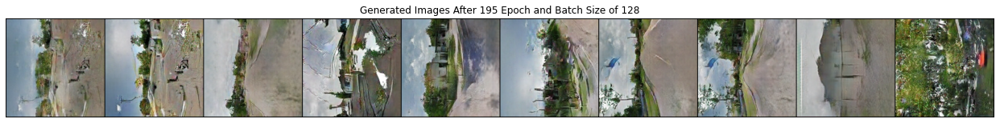

In [35]:
for i in range(75,200,10):
  qualitative_evaluation(train_10_dl, i, 128)

### Test Dataset

In [36]:
test_10_ds = ImageFolder(test_10_data_path, transform=transforms.Compose([Transformations()]))
test_10_dl = DataLoader(test_10_ds, batch_size, shuffle=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


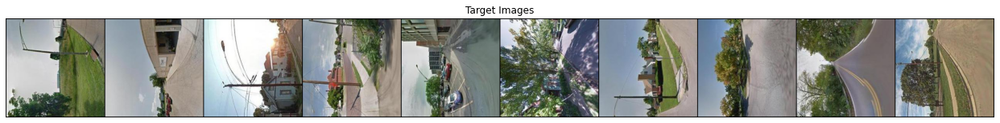

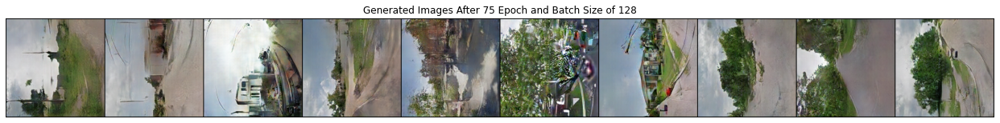

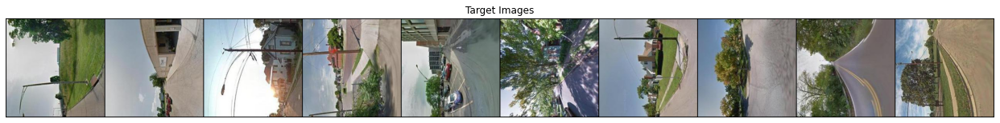

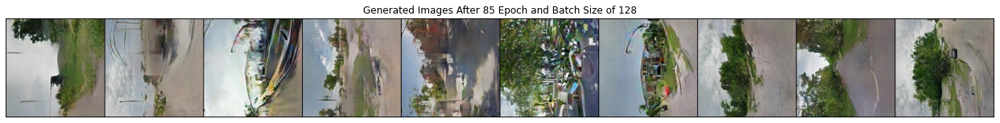

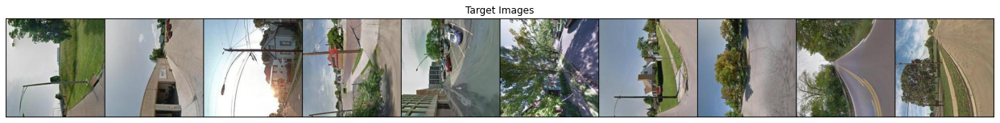

...

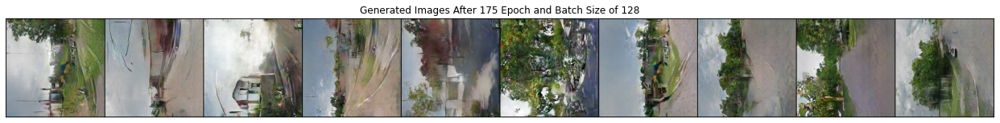

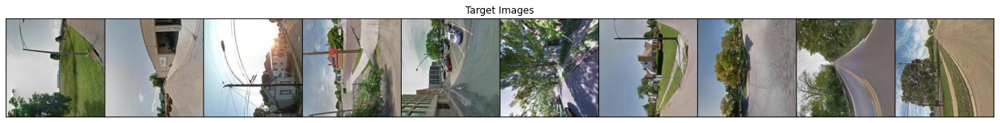

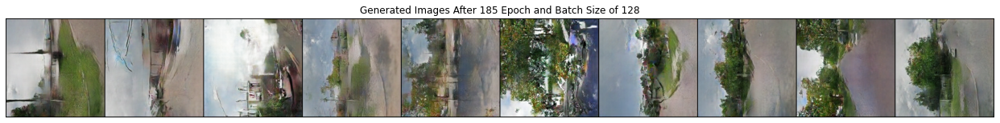

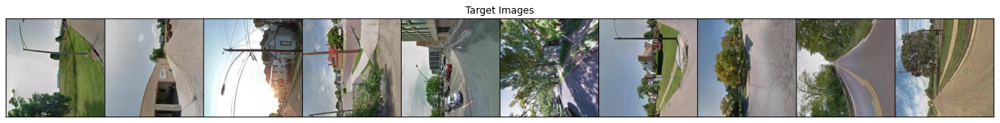

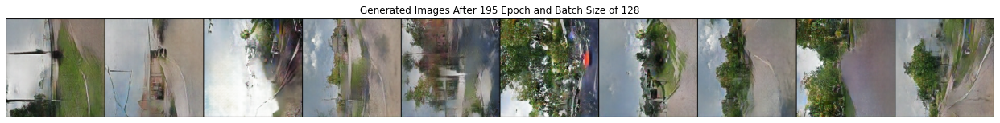

In [37]:
for i in range(75,201,10):
  qualitative_evaluation(test_10_dl, i, 128)

### Batch Size 24 -> 75 Epochs
---

### Train Dataset

In [38]:
train_10_ds = ImageFolder(train_10_data_path, transform=transforms.Compose([Transformations()]))
train_10_dl = DataLoader(train_10_ds, batch_size, shuffle=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


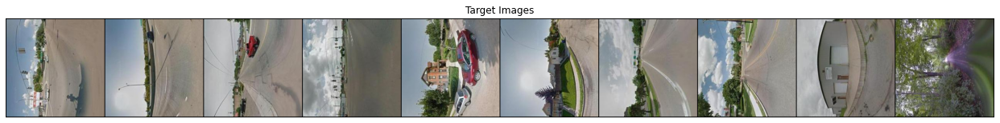

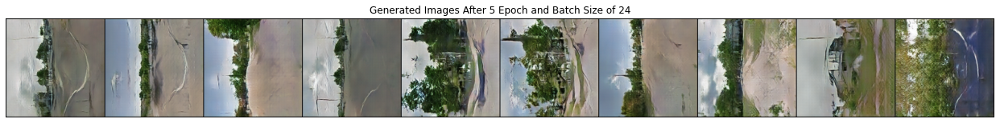

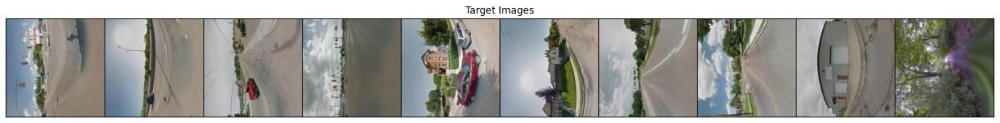

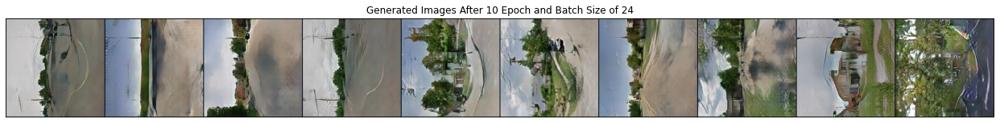

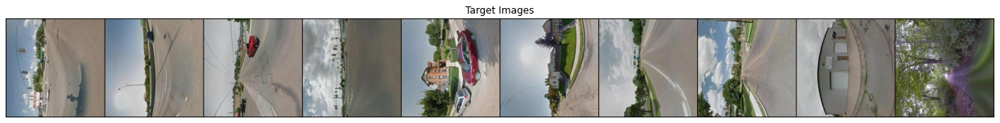

...

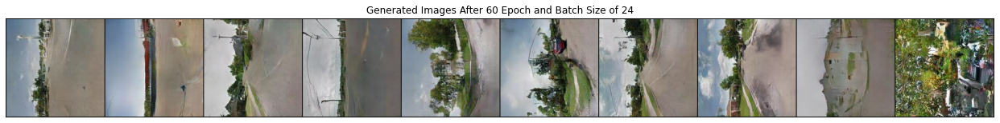

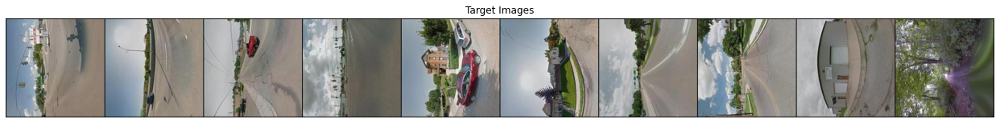

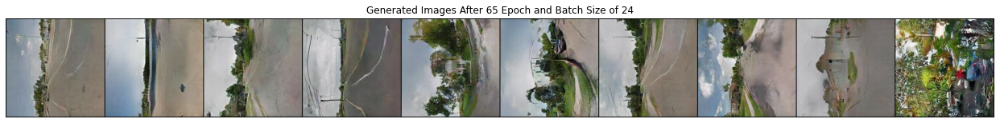

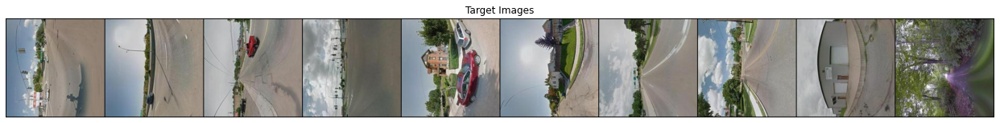

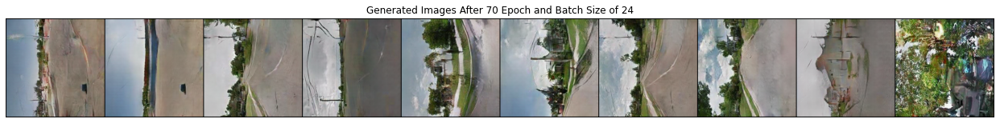

In [50]:
for i in range(5,75,5):
  qualitative_evaluation(train_10_dl, i,24)

### Test Dataset

In [51]:
test_10_ds = ImageFolder(test_10_data_path, transform=transforms.Compose([Transformations()]))
test_10_dl = DataLoader(test_10_ds, batch_size, shuffle=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


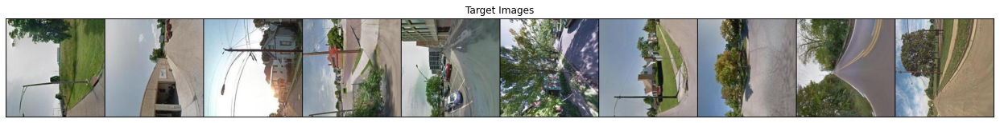

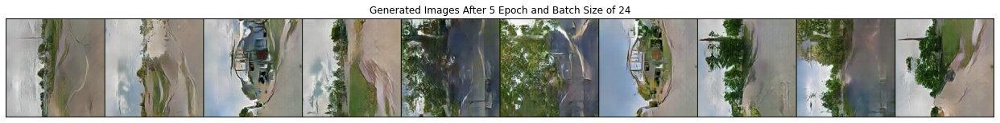

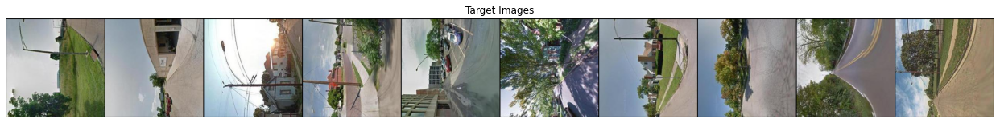

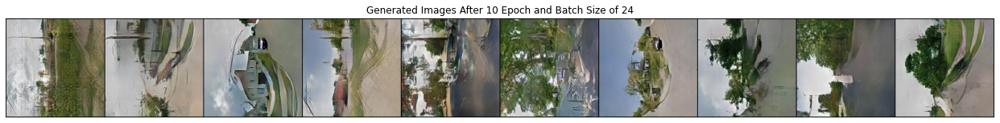

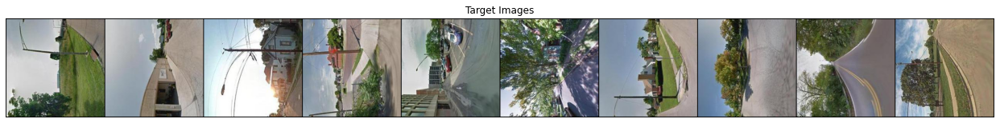

...

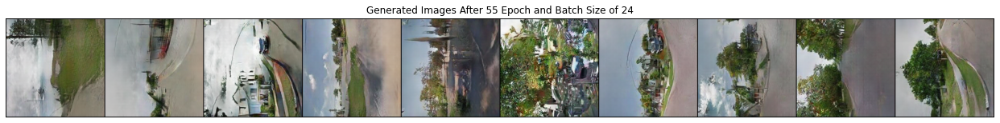

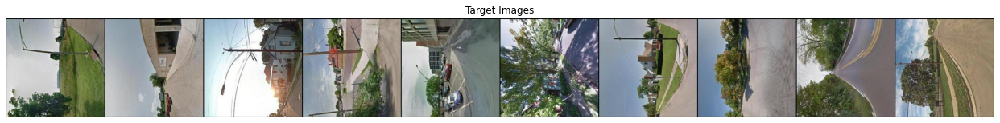

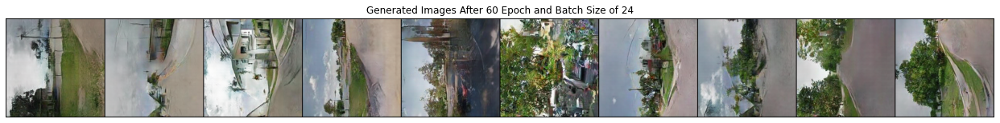

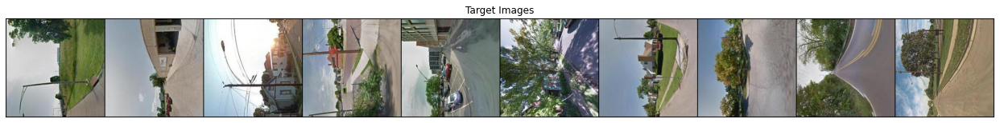

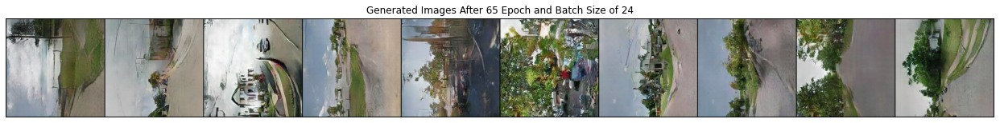

In [52]:
for i in range(5,70,5):
  qualitative_evaluation(test_10_dl, i)

### Batch Size 1 -> 30 Epochs
---

### Train Dataset

In [53]:
train_10_ds = ImageFolder(train_10_data_path, transform=transforms.Compose([Transformations()]))
train_10_dl = DataLoader(train_10_ds, batch_size, shuffle=False)

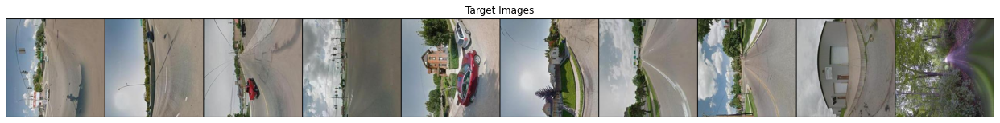

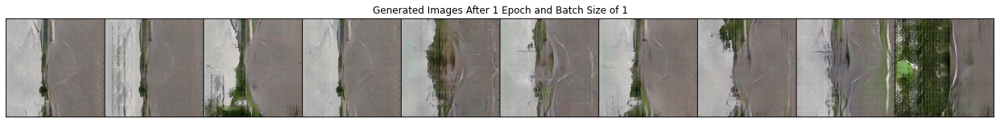

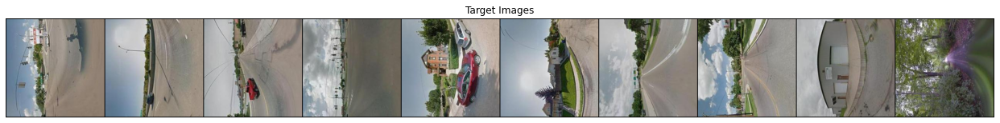

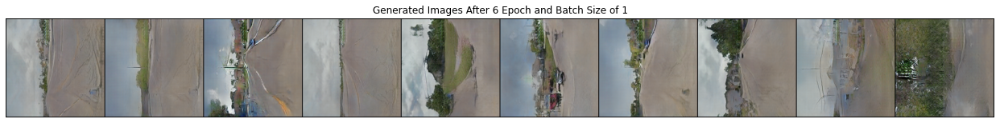

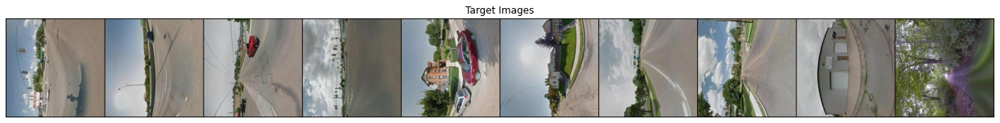

...

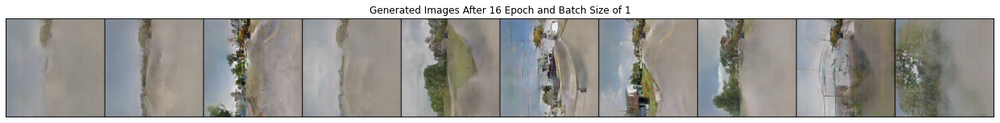

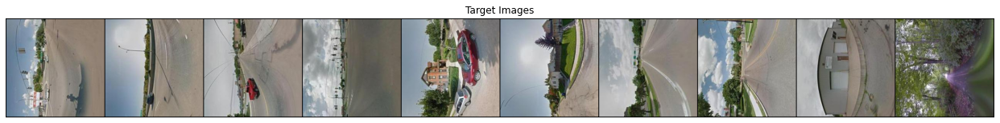

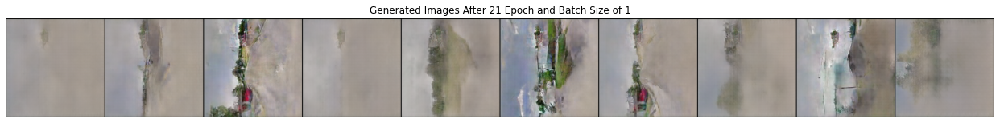

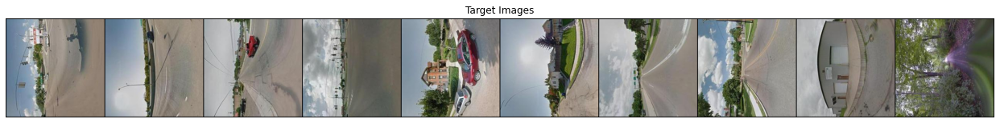

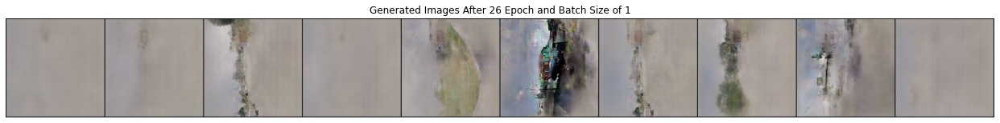

In [54]:
for i in range(1,31,5):
  qualitative_evaluation(train_10_dl, i,1)

### Test Dataset

In [55]:
test_10_ds = ImageFolder(test_10_data_path, transform=transforms.Compose([Transformations()]))
test_10_dl = DataLoader(test_10_ds, batch_size, shuffle=False)

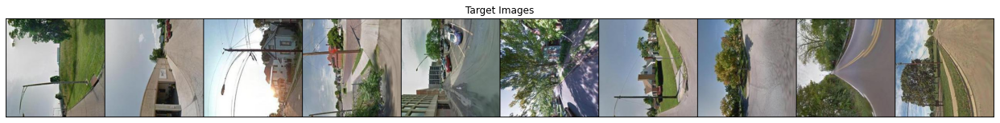

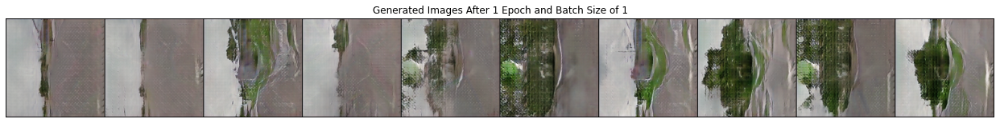

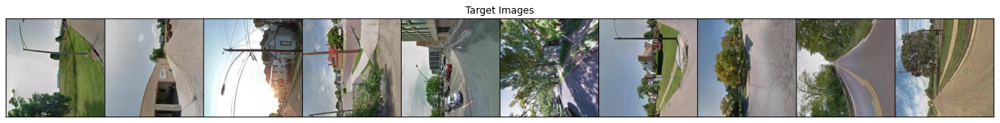

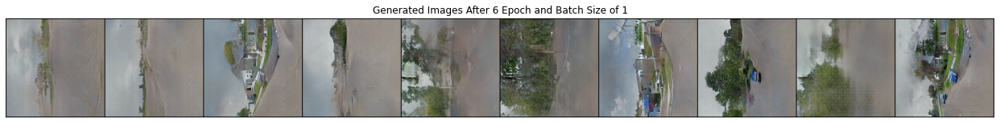

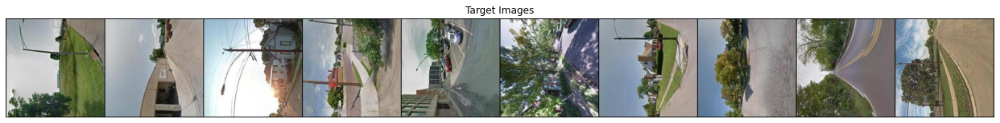

...

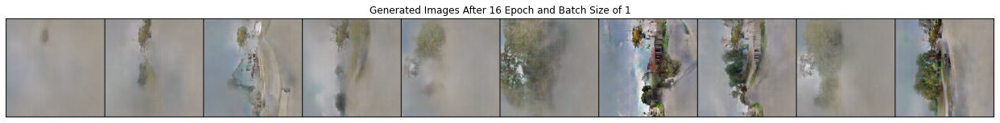

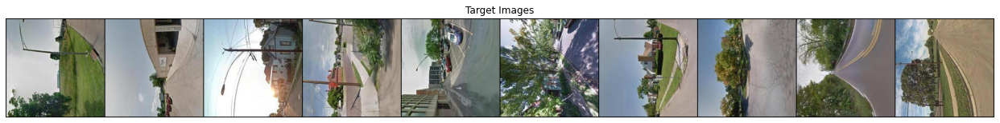

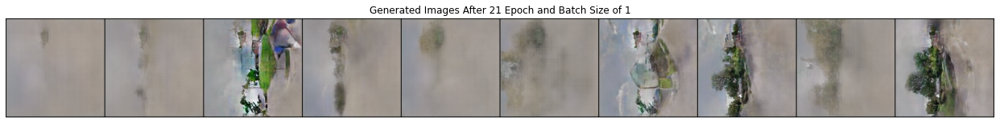

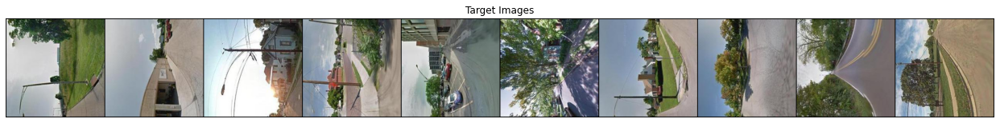

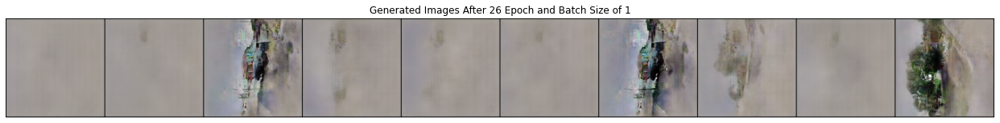

In [57]:
for i in range(1,31,5):
  qualitative_evaluation(test_10_dl, i,1)